# Detecção de anomalias

## Teoria

### O que é?

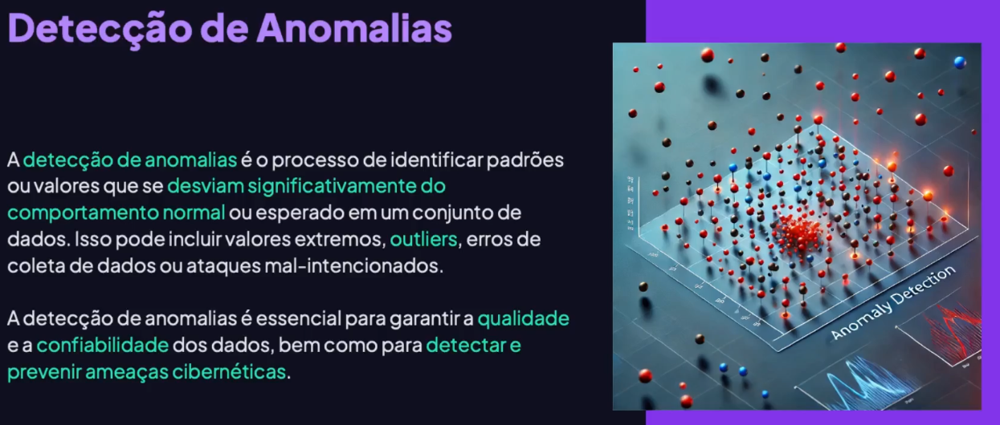

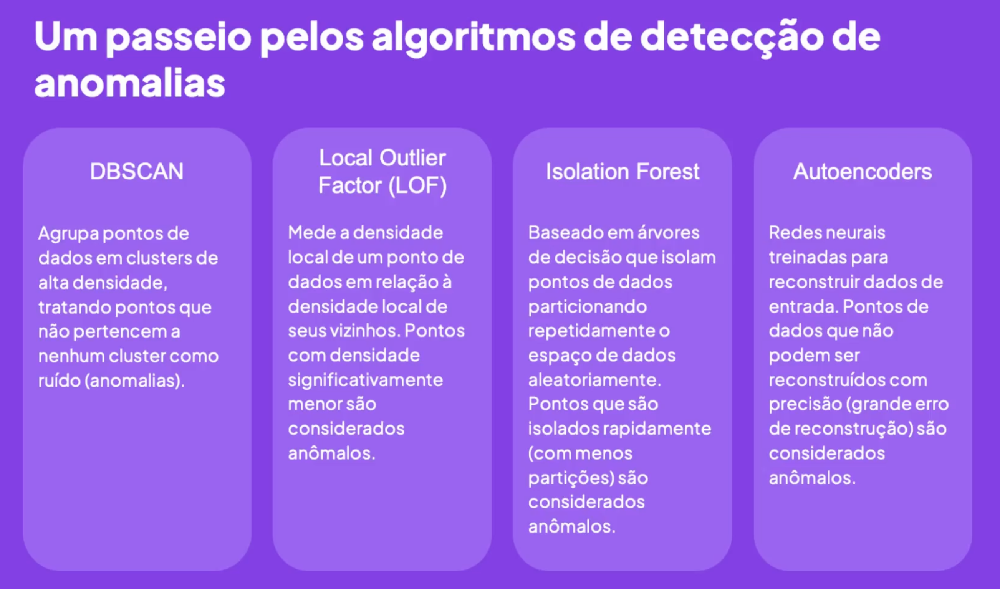

### Casos de uso

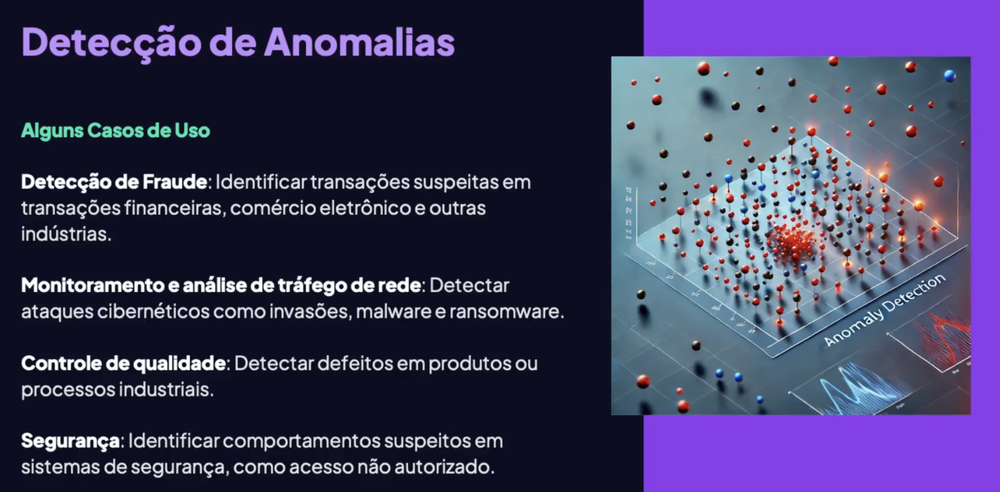

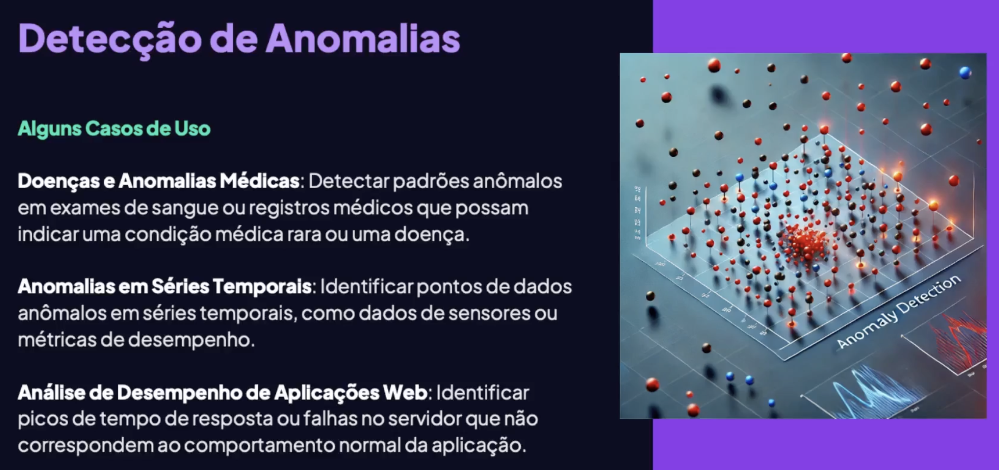

### Algoritmo LOF

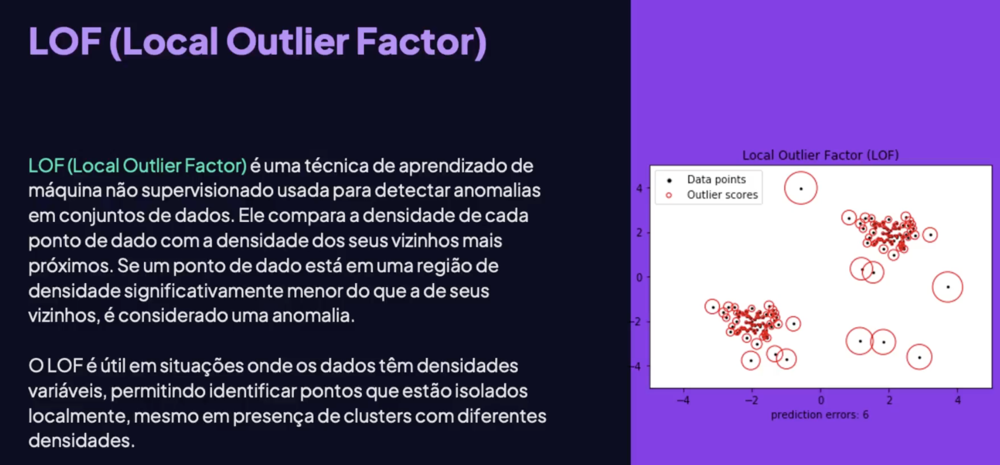

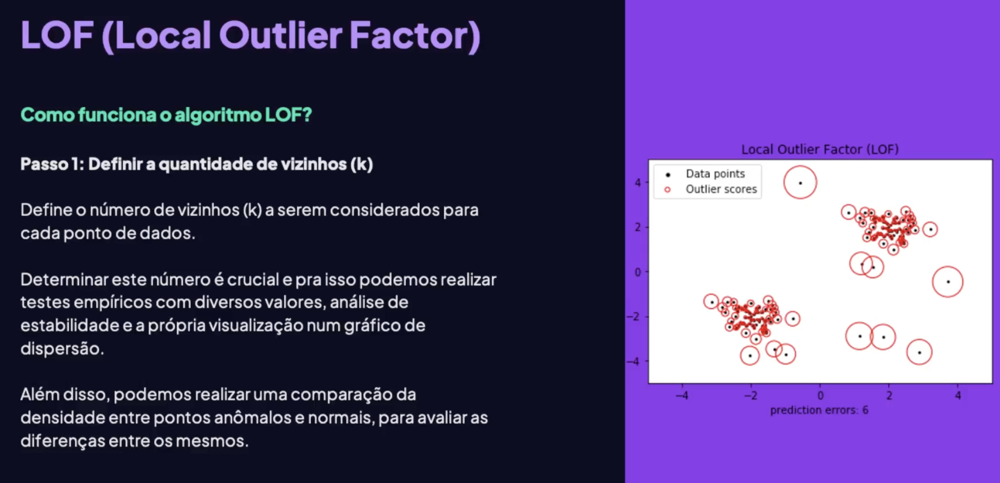

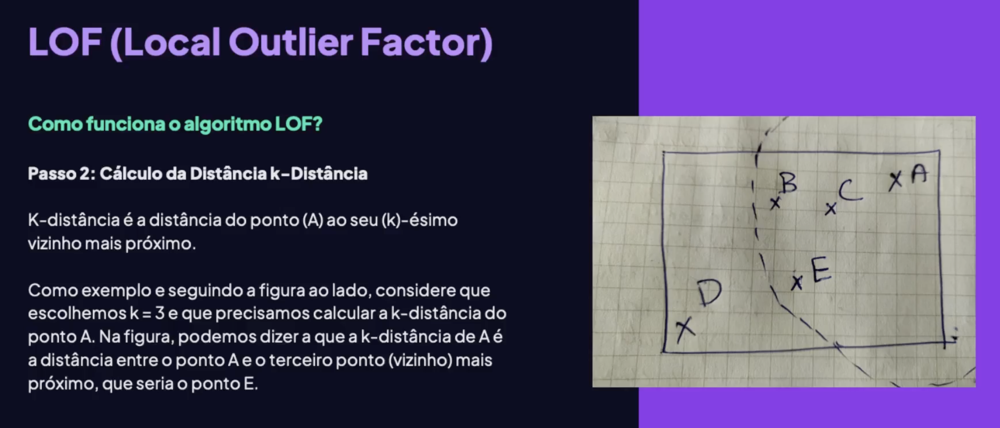

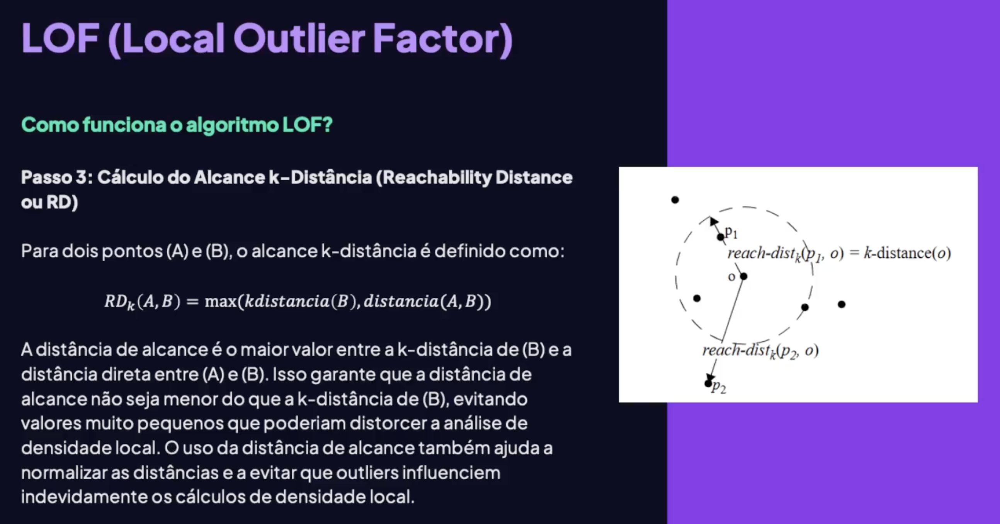

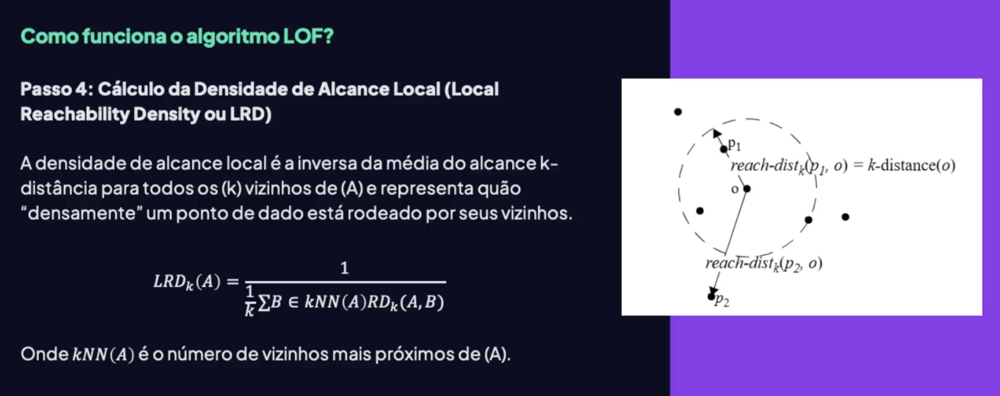

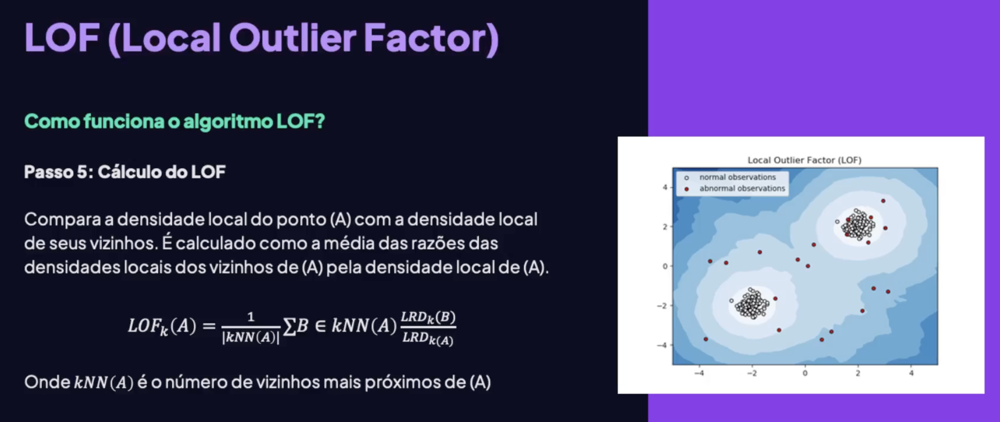

## Importações

In [20]:
import pandas as pd
import numpy as np

from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.metrics import recall_score

## Carga de dados

In [2]:
df_churn = pd.read_csv('./dataset/clients_churn.csv')

In [3]:
df_churn.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7032 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   IDCliente         7032 non-null   object 
 1   Genero            7032 non-null   object 
 2   Mais65anos        7032 non-null   int64  
 3   TemParceiro       7032 non-null   object 
 4   TemDependentes    7032 non-null   object 
 5   PhoneService      7032 non-null   object 
 6   MultipleLines     7032 non-null   object 
 7   InternetService   7032 non-null   object 
 8   OnlineSecurity    7032 non-null   object 
 9   OnlineBackup      7032 non-null   object 
 10  DeviceProtection  7032 non-null   object 
 11  TechSupport       7032 non-null   object 
 12  StreamingTV       7032 non-null   object 
 13  StreamingMovies   7032 non-null   object 
 14  tenure            7032 non-null   int64  
 15  Contract          7032 non-null   object 
 16  PaperlessBilling  7032 non-null   object 


In [4]:
df_churn.head(5)

,IDCliente,Genero,Mais65anos,TemParceiro,TemDependentes,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,...,TechSupport,StreamingTV,StreamingMovies,tenure,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,No,No phone service,DSL,No,Yes,...,No,No,No,1,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,Yes,No,DSL,Yes,No,...,No,No,No,34,One year,No,Mailed check,56.95,1889.50,No
2,3668-QPYBK,Male,0,No,No,Yes,No,DSL,Yes,Yes,...,No,No,No,2,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,No,No phone service,DSL,Yes,No,...,Yes,No,No,45,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,Yes,No,Fiber optic,No,No,...,No,No,No,2,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
# Contar clientes usando a variável Churn
df_churn.Churn.value_counts()

Churn
No     5163
Yes    1869
Name: count, dtype: int64

In [7]:
# Distribuição percentual de clientes usando a variável Churn
df_churn.Churn.value_counts(normalize=True) * 100

Churn
No     73.421502
Yes    26.578498
Name: proportion, dtype: float64

## Preparação do dataset

In [8]:
# Selecionar as colunas para o algoritmo
X = df_churn.drop(columns=['IDCliente', 'Churn'])
y = df_churn['Churn']

In [9]:
# Definir uma função para transformar as colunas booleanas
def binary_transformer_func(x):
  return x.map(lambda x: 1 if x == 'Yes' else 0)

In [10]:
# Definir as colunas por tipo
numeric_features = ['tenure', 'MonthlyCharges', 'TotalCharges']
categorical_features = ['Genero', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaymentMethod']
binary_features = ['TemParceiro', 'TemDependentes', 'TechSupport', 'PhoneService', 'PaperlessBilling']
no_transformation_features = ['Mais65anos']

# Criar os transformadores para cada tipo de coluna
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder()
binary_transformer = FunctionTransformer(binary_transformer_func)

# Criar o preprocessor para aplicar os transformadores em cada tipo de coluna
preprocessor = ColumnTransformer(
		transformers=[
				('num', numeric_transformer, numeric_features),
				('cat', categorical_transformer, categorical_features),
				('bin', binary_transformer, binary_features),
        ('pass', 'passthrough', no_transformation_features),
		],
)

# Transformar os dados usando o preprocessor
X_transformed = preprocessor.fit_transform(X)

In [12]:
# Visualizar X_transformed
X_transformed.shape

(7032, 39)

## Treinamento do algoritmo LOF

In [44]:
# Instancia objeto LOF
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.26)

In [45]:
# Treinar e Gerar os scores de anomalia para cada registro
y_pred = lof.fit_predict(X_transformed)

In [46]:
# Mostrar valores preditos (anomalia ou não anomalia)
# No sklearn, valores -1 são considerados anomalias e 1 são considerados normais
y_pred

array([ 1,  1,  1, ...,  1, -1,  1])

In [47]:
# Mostrar o LOF calculado para cada registro
# No sklearn, o LOF calculado fica na propriedade negative_outlier_factor_
# negative_outlier_factor_ é o oposto do LOF, ou seja, quanto menor o valor, mais anômalo é o registro
-lof.negative_outlier_factor_

array([1.0238333 , 1.03547225, 1.02610568, ..., 1.07053634, 1.19840027,
       1.08901757])

## Apresentar resultados

In [48]:
# Identificar anomalias
outliers = y_pred == -1
inliers = y_pred == 1

# Contar o número de anomalias e inliers
n_outliers = np.sum(outliers)
n_inliers = np.sum(inliers)

# Apresentar os resultados
print(f'Número de anomalias: {n_outliers}')
print(f'Número de inliers: {n_inliers}')

Número de anomalias: 1829
Número de inliers: 5203


In [36]:
# Converter y para a mesma base do y_pred
y_true = y.map(lambda x: -1 if x == 'Yes' else 1)

In [49]:
# Calcular Score com base no valor de y (Churn real da base)
# Usar Recall, pois o objetivo principal é maximizar o TPR (True Positive Rate)
recall_score(y_true, y_pred)

np.float64(0.7515010652721286)